# Совместная работа по машинному обучения

### Группа выполнившая работу
* ##### 22П-3

### Состав команды
* ##### Рахмаев Данил
* ##### Кушхов Руслан

# План работы
1. Установка недостающих библиотек
1. Подключение библиотек
2. Подключение датасета с текстом на разных языках
3. Определить необходимые поля и создать структуру набора данных
4. Провести предварительную обработку текстов размеченного датасета
5. Провести тематическое моделирование
6. Векторизация
7. Классификация
8. Парсинг новых данных

## Установка недостающих библиотек

In [178]:
pip install pymorphy3

Note: you may need to restart the kernel to use updated packages.


In [180]:
pip install inltk

Note: you may need to restart the kernel to use updated packages.


In [181]:
pip install indic-nlp-library

Note: you may need to restart the kernel to use updated packages.


In [182]:
pip install -U spacy

Note: you may need to restart the kernel to use updated packages.


In [183]:
pip install WordCloud

Note: you may need to restart the kernel to use updated packages.


## Подключение библиотек

In [185]:
import pandas
import pandas as pd
import nltk
import string
import re
import pymorphy3

from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem.snowball import SnowballStemmer

from sklearn.decomposition import TruncatedSVD

In [186]:
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('punkt_tab')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\rakhm\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\rakhm\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\rakhm\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt_tab is already up-to-date!


True

## Подключение датасета

In [188]:
df_lang = pd.read_csv("TextLanguage.csv", encoding='utf-8-sig')

### Информация о датасете

In [190]:
df_lang.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10337 entries, 0 to 10336
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   Text      10337 non-null  object
 1   Language  10337 non-null  object
dtypes: object(2)
memory usage: 161.6+ KB


In [192]:
df_lang.head(5)

,Text,Language
0,"Nature, in the broadest sense, is the natural...",English
1,"""Nature"" can refer to the phenomena of the phy...",English
2,"The study of nature is a large, if not the onl...",English
3,"Although humans are part of nature, human acti...",English
4,[1] The word nature is borrowed from the Old F...,English


#### Получаем языки используемые в датасете

In [194]:
df_lang["Language"].unique()

array(['English', 'Malayalam', 'Hindi', 'Tamil', 'Portugeese', 'French',
       'Dutch', 'Spanish', 'Greek', 'Russian', 'Danish', 'Italian',
       'Turkish', 'Sweedish', 'Arabic', 'German', 'Kannada'], dtype=object)

#### Получаем количество записей для каждого языка

In [196]:
language_counts = df_lang['Language'].value_counts()

In [197]:
language_counts

Language
English       1385
French        1014
Spanish        819
Portugeese     739
Italian        698
Russian        692
Sweedish       676
Malayalam      594
Dutch          546
Arabic         536
Turkish        474
German         470
Tamil          469
Danish         428
Kannada        369
Greek          365
Hindi           63
Name: count, dtype: int64

#### Пример текста для каждого языка

In [199]:
lang_to_example = df_lang.groupby('Language')['Text'].first().to_dict()

max_words = 20  # Максимальное количество слов в примере

for lang, text in lang_to_example.items():
    truncated_text = ' '.join(text.split()[:max_words])
    if len(text.split()) > max_words:
        truncated_text += ""
    
    print(f"\n\033[1;35m╔{'═' * 50}╗\033[0m")
    print(f"\033[1;35m║\033[1;36m {lang.upper():^48} \033[1;35m║\033[0m")
    print(f"\033[1;35m╚{'═' * 50}╝\033[0m")
    print(f"\033[0;33mПример:\033[0m\n{truncated_text}\n")


╔══════════════════════════════════════════════════╗
║                      ARABIC                      ║
╚══════════════════════════════════════════════════╝
Пример:
نيتشر (بالإنجليزية: Nature)‏ قد تعني: تعديل - تعديل مصدري - تعديل ويكي بيانات ويكيبيديا (تلفظ ‎[wi:ki:bi:dija:]‏ وتلحن ‎[wikipi:dia]‏؛ تلفظ بالإنجليزية


╔══════════════════════════════════════════════════╗
║                      DANISH                      ║
╚══════════════════════════════════════════════════╝
Пример:
Nature er et britisk multidisciplinært videnskabeligt tidsskrift, der blev udgivet første gang den 4. november 1869.


╔══════════════════════════════════════════════════╗
║                      DUTCH                       ║
╚══════════════════════════════════════════════════╝
Пример:
Nature (Engels voor 'natuur') is een Brits vooral natuurwetenschappelijk tijdschrift.


╔══════════════════════════════════════════════════╗
║                     ENGLISH                      ║
╚══════════════════════════════

## Предварительная обработка данных

* Полноценная очистка текста
* Лемматизация
* Токенизация по словам
* Удаление стоп слов

#### Функции для очистки текста:

In [203]:
st= '❯\xa0—–«»”“•'

def remove_punctuation(text): 
    return text.translate(str.maketrans('', '', string.punctuation))

def remove_numbers(text): 
    return re.sub(r'\d+', ' ', text)

def remove_multiple_spaces(text):
    return re.sub(r'\s+', ' ', text, flags=re.I).strip()

def remove_special_symbols(text):
    return text.translate(str.maketrans('', '', st))

def clean_text(text):
    text = text.lower()
    text = remove_punctuation(text)
    text = remove_special_symbols(text)
    text = remove_numbers(text)
    text = remove_multiple_spaces(text)
    return text

In [204]:
df_lang['prep_text'] = [clean_text(text) for text in df_lang['Text']]

In [206]:
df_lang = df_lang[['Language', 'Text', 'prep_text']]

#### Обработвнный текст (для каждого языка первая запись)

In [208]:
df_first = df_lang.groupby('Language').first().reset_index()
df_first.head(17)

,Language,Text,prep_text
0,Arabic,نيتشر (بالإنجليزية: Nature)‏ قد تعني: تعديل...,نيتشر بالإنجليزية nature‏ قد تعني تعديل تعديل ...
1,Danish,Nature er et britisk multidisciplinært vidensk...,nature er et britisk multidisciplinært vidensk...
2,Dutch,Nature (Engels voor 'natuur') is een Brits voo...,nature engels voor natuur is een brits vooral ...
3,English,"Nature, in the broadest sense, is the natural...",nature in the broadest sense is the natural ph...
4,French,Si vous disposez d'ouvrages ou d'articles de r...,si vous disposez douvrages ou darticles de réf...
5,German,.Wir sind alle auf der Suche nach schnellen We...,wir sind alle auf der suche nach schnellen weg...
6,Greek,Δεν υπάρχει αυτή τη στιγμή λήμμα με αυτόν τον...,δεν υπάρχει αυτή τη στιγμή λήμμα με αυτόν τον ...
7,Hindi,विकि-शब्दकोष (एक मुक्त शब्दकोष एवं समानांतर को...,विकिशब्दकोष एक मुक्त शब्दकोष एवं समानांतर कोष ...
8,Italian,Nature è una delle più antiche ed importanti r...,nature è una delle più antiche ed importanti r...
9,Kannada,.ನಾವೆಲ್ಲರೂ ಇಂಗ್ಲಿಷ್ನಲ್ಲಿ ಹೆಚ್ಚು ನಿರರ್ಗಳವಾಗಲು ತ...,ನಾವೆಲ್ಲರೂ ಇಂಗ್ಲಿಷ್ನಲ್ಲಿ ಹೆಚ್ಚು ನಿರರ್ಗಳವಾಗಲು ತ್...


In [209]:
df_lang.iloc[2200:8000]

,Language,Text,prep_text
2200,Tamil,ஒரு தொலைபேசி அழைப்பில் பயன்படுத்த ஸ்மார்ட் சொற...,ஒரு தொலைபேசி அழைப்பில் பயன்படுத்த ஸ்மார்ட் சொற...
2201,Tamil,"அதற்கான விளக்க பெட்டியில் கீழே, இப்போது ரகசிய ...",அதற்கான விளக்க பெட்டியில் கீழே இப்போது ரகசிய ம...
2202,Tamil,நாங்கள் மிகவும் உற்சாகமாக இருக்கிறோம்.,நாங்கள் மிகவும் உற்சாகமாக இருக்கிறோம்
2203,Tamil,நாங்கள் ' இந்த ஸ்மார்ட் சொற்களை நாங்கள் நிறைய ...,நாங்கள் இந்த ஸ்மார்ட் சொற்களை நாங்கள் நிறைய கற...
2204,Tamil,எனவே ஒரு நேரத்தில் நீங்கள் உச்சரிக்கிறீர்கள் எ...,எனவே ஒரு நேரத்தில் நீங்கள் உச்சரிக்கிறீர்கள் எ...
...,...,...,...
7995,Turkish,"Bu başlamak için en iyi videodur, bu yüzden 10...",bu başlamak için en iyi videodur bu yüzden dak...
7996,Turkish,bir numaralı ifade bu sormanın başka bir yoludur.,bir numaralı ifade bu sormanın başka bir yoludur
7997,Turkish,nasılsın?,nasılsın
7998,Turkish,Nasıl gidiyor?,nasıl gidiyor


#### Отдельный пример обработанного текста

In [211]:
print("Не обработанный текст:")
df_lang['Text'][9000]

Не обработанный текст:


'[28][29] استشهدت صحيفة وول ستريت جورنال بمجموعة من القواعد المطبقة على التحرير والنزاعات المتعلقة بمثل هذا المحتوى من بين أسباب هذا الاتجاه.'

In [212]:
print("Обработанный текст:")
df_lang['prep_text'][9000]

Обработанный текст:


'استشهدت صحيفة وول ستريت جورنال بمجموعة من القواعد المطبقة على التحرير والنزاعات المتعلقة بمثل هذا المحتوى من بين أسباب هذا الاتجاه'

## Токенизация текста

In [214]:
stopwords_dict = {
    'russian': set(stopwords.words('russian')),
    'english': set(stopwords.words('english')),
    'french': set(stopwords.words('french')),
    'spanish': set(stopwords.words('spanish')),
    'portuguese': set(stopwords.words('portuguese')),
    'italian': set(stopwords.words('italian')),
    'swedish': set(stopwords.words('swedish')),
    'dutch': set(stopwords.words('dutch')),
    'arabic': set(stopwords.words('arabic')),
    'turkish': set(stopwords.words('turkish')),
    'german': set(stopwords.words('german')),
    'danish': set(stopwords.words('danish')),
    'greek': set(stopwords.words('greek')),
}

all_stopwords = set()
for lang in stopwords_dict.values():
    all_stopwords.update(lang)

def tokenize(text):
    tokens = word_tokenize(text)
    tokens = [token for token in tokens if token.lower() not in all_stopwords]
    return " ".join(tokens)

In [216]:
df_lang['tokenize_text'] = [tokenize(text) for text in df_lang['prep_text']]

#### Токенизированный текст (для каждого языка первая запись)

In [217]:
df_first = df_lang.groupby('Language').first().reset_index()
df_first.head(17)

,Language,Text,prep_text,tokenize_text
0,Arabic,نيتشر (بالإنجليزية: Nature)‏ قد تعني: تعديل...,نيتشر بالإنجليزية nature‏ قد تعني تعديل تعديل ...,نيتشر بالإنجليزية nature‏ تعني تعديل تعديل مصد...
1,Danish,Nature er et britisk multidisciplinært vidensk...,nature er et britisk multidisciplinært vidensk...,nature britisk multidisciplinært videnskabelig...
2,Dutch,Nature (Engels voor 'natuur') is een Brits voo...,nature engels voor natuur is een brits vooral ...,nature engels natuur brits vooral natuurwetens...
3,English,"Nature, in the broadest sense, is the natural...",nature in the broadest sense is the natural ph...,nature broadest sense natural physical materia...
4,French,Si vous disposez d'ouvrages ou d'articles de r...,si vous disposez douvrages ou darticles de réf...,disposez douvrages darticles référence connais...
5,German,.Wir sind alle auf der Suche nach schnellen We...,wir sind alle auf der suche nach schnellen weg...,suche schnellen wegen fließender englisch spre...
6,Greek,Δεν υπάρχει αυτή τη στιγμή λήμμα με αυτόν τον...,δεν υπάρχει αυτή τη στιγμή λήμμα με αυτόν τον ...,υπάρχει αυτή τη στιγμή λήμμα αυτόν τίτλο
7,Hindi,विकि-शब्दकोष (एक मुक्त शब्दकोष एवं समानांतर को...,विकिशब्दकोष एक मुक्त शब्दकोष एवं समानांतर कोष ...,विकिशब्दकोष एक मुक्त शब्दकोष एवं समानांतर कोष ...
8,Italian,Nature è una delle più antiche ed importanti r...,nature è una delle più antiche ed importanti r...,nature antiche importanti riviste scientifiche...
9,Kannada,.ನಾವೆಲ್ಲರೂ ಇಂಗ್ಲಿಷ್ನಲ್ಲಿ ಹೆಚ್ಚು ನಿರರ್ಗಳವಾಗಲು ತ...,ನಾವೆಲ್ಲರೂ ಇಂಗ್ಲಿಷ್ನಲ್ಲಿ ಹೆಚ್ಚು ನಿರರ್ಗಳವಾಗಲು ತ್...,ನಾವೆಲ್ಲರೂ ಇಂಗ್ಲಿಷ್ನಲ್ಲಿ ಹೆಚ್ಚು ನಿರರ್ಗಳವಾಗಲು ತ್...


## Лемматизация текста

In [248]:
from nltk.stem import WordNetLemmatizer
from functools import lru_cache
from nltk import download
from nltk.tokenize import word_tokenize
from nltk.stem import (
    SnowballStemmer,
    ISRIStemmer,
    WordNetLemmatizer
)

In [250]:
morph_ru = pymorphy3.MorphAnalyzer(lang='ru')
stemmer_en = WordNetLemmatizer()
stemmer_ar = ISRIStemmer()
stemmers = {
    lang: SnowballStemmer(lang) for lang in [
        'danish', 'dutch', 'french', 'german',
        'italian', 'norwegian', 'portuguese',
        'romanian', 'spanish', 'swedish'
    ]
}

@lru_cache(maxsize=100000)
def lemmatize_word(word: str, lang: str) -> str:
    try:
        if lang == 'russian':
            return morph_ru.parse(word)[0].normal_form
        elif lang == 'english':
            return stemmer_en.lemmatize(word)
        elif lang == 'arabic':
            return stemmer_ar.stem(word)
        elif lang in stemmers:
            return stemmers[lang].stem(word)
        return word
    except Exception:
        return word

def lemmatize_text(text: str, lang: str) -> str:
    words = word_tokenize(text.lower())
    return ' '.join(lemmatize_word(word, lang) for word in words if word)

def add_lemmatization(df: pd.DataFrame) -> pd.DataFrame:
    df['lemm_text'] = df.apply(
        lambda row: lemmatize_text(row['tokenize_text'], row['Language'].lower()),
        axis=1
    )
    return df

df_lang = add_lemmatization(df_lang)

#### Лемматизированный текст (для каждого языка первая запись)

In [252]:
df_first = df_lang.groupby('Language').first().reset_index()
df_first.head(17)

,Language,Text,prep_text,tokenize_text,lemm_text
0,Arabic,نيتشر (بالإنجليزية: Nature)‏ قد تعني: تعديل...,نيتشر بالإنجليزية nature‏ قد تعني تعديل تعديل ...,نيتشر بالإنجليزية nature‏ تعني تعديل تعديل مصد...,تشر انجليزية nature‏ تعن عدل عدل صدر عدل ويك ب...
1,Danish,Nature er et britisk multidisciplinært vidensk...,nature er et britisk multidisciplinært vidensk...,nature britisk multidisciplinært videnskabelig...,natur britisk multidisciplinært videnskab tids...
2,Dutch,Nature (Engels voor 'natuur') is een Brits voo...,nature engels voor natuur is een brits vooral ...,nature engels natuur brits vooral natuurwetens...,natur engel natur brit vooral natuurwetenschap...
3,English,"Nature, in the broadest sense, is the natural...",nature in the broadest sense is the natural ph...,nature broadest sense natural physical materia...,nature broadest sense natural physical materia...
4,French,Si vous disposez d'ouvrages ou d'articles de r...,si vous disposez douvrages ou darticles de réf...,disposez douvrages darticles référence connais...,dispos douvrag darticl référent connaiss sit w...
5,German,.Wir sind alle auf der Suche nach schnellen We...,wir sind alle auf der suche nach schnellen weg...,suche schnellen wegen fließender englisch spre...,such schnell weg fliessend englisch sprech
6,Greek,Δεν υπάρχει αυτή τη στιγμή λήμμα με αυτόν τον...,δεν υπάρχει αυτή τη στιγμή λήμμα με αυτόν τον ...,υπάρχει αυτή τη στιγμή λήμμα αυτόν τίτλο,υπάρχει αυτή τη στιγμή λήμμα αυτόν τίτλο
7,Hindi,विकि-शब्दकोष (एक मुक्त शब्दकोष एवं समानांतर को...,विकिशब्दकोष एक मुक्त शब्दकोष एवं समानांतर कोष ...,विकिशब्दकोष एक मुक्त शब्दकोष एवं समानांतर कोष ...,विकिशब्दकोष एक मुक्त शब्दकोष एवं समानांतर कोष ...
8,Italian,Nature è una delle più antiche ed importanti r...,nature è una delle più antiche ed importanti r...,nature antiche importanti riviste scientifiche...,natur antic import rivist scientif esistent fo...
9,Kannada,.ನಾವೆಲ್ಲರೂ ಇಂಗ್ಲಿಷ್ನಲ್ಲಿ ಹೆಚ್ಚು ನಿರರ್ಗಳವಾಗಲು ತ...,ನಾವೆಲ್ಲರೂ ಇಂಗ್ಲಿಷ್ನಲ್ಲಿ ಹೆಚ್ಚು ನಿರರ್ಗಳವಾಗಲು ತ್...,ನಾವೆಲ್ಲರೂ ಇಂಗ್ಲಿಷ್ನಲ್ಲಿ ಹೆಚ್ಚು ನಿರರ್ಗಳವಾಗಲು ತ್...,ನಾವೆಲ್ಲರೂ ಇಂಗ್ಲಿಷ್ನಲ್ಲಿ ಹೆಚ್ಚು ನಿರರ್ಗಳವಾಗಲು ತ್...


#### Лемматизированный текст (для русского языка)

In [256]:
df_lang[df_lang["Language"] == 'Russian']

,Language,Text,prep_text,tokenize_text,lemm_text
5994,Russian,Nature (в переводе с англ.,nature впереводе сангл,nature впереводе сангл,nature вперевод сангл
5995,Russian,— «Природа») — один из самых старых и авторите...,природа один из самых старых и авторитетных об...,природа самых старых авторитетных общенаучных ...,природа самый старый авторитетный общенаучный ...
5996,Russian,"Публикует исследования, посвящённые широкому к...",публикует исследования посвящённые широкому кр...,публикует исследования посвящённые широкому кр...,публиковать исследование посвятить широкий кру...
5997,Russian,Первый номер журнала Nature был издан 4 ноября...,первый номер журнала nature был издан ноября г...,первый номер журнала nature издан ноября года ...,первый номер журнал nature издать ноябрь год а...
5998,Russian,Nature редактируется в Великобритании издатель...,nature редактируется в великобритании издатель...,nature редактируется великобритании издательст...,nature редактироваться великобритания издатель...
...,...,...,...,...,...
6681,Russian,Однажды Мелли и Терри снова пришли встретиться...,однажды мелли и терри снова пришли встретиться...,однажды мелли терри снова пришли встретиться м...,однажды мелли терри снова прислать встретиться...
6682,Russian,"О, привет, вы двое, так скажите нам Мэриан.",о привет вы двое так скажите нам мэриан,привет двое скажите нам мэриан,привет двое сказать мы мэриана
6683,Russian,Как' теперь нарциссизм Мэриан рассказал им обо...,как теперь нарциссизм мэриан рассказал им обои...,нарциссизм мэриан рассказал обоим произошло си...,нарциссизм мэриана рассказать оба произойти си...
6684,Russian,"Думаю, она не хотела бы больше золотого хлеба,...",думаю она не хотела бы больше золотого хлеба а...,думаю хотела золотого хлеба знаешь,думать хотеть золотой хлеб знать


#### Отдельный пример лемматизированного текста

In [274]:
print("Не лемматизированный текст:")
df_lang["Text"][6000]

Не лемматизированный текст:


'Журнал ориентирован на научных работников, однако в начале каждого издания публикуется краткое популярное изложение важнейших публикаций.'

In [276]:
print("Лемматизированный текст:")
df_lang["lemm_text"][6000]

Лемматизированный текст:


'журнал ориентировать научный работник однако начало каждый издание публиковаться краткий популярный изложение важный публикация'

## Облако слов

In [281]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt
%matplotlib inline

#### Функции для генерации облаков слов

In [283]:
# Получение текстовой строки из списка слов
def str_corpus(corpus):
    str_corpus = ''
    for i in corpus:
        str_corpus += ' ' + i
    str_corpus = str_corpus.strip()
    return str_corpus

# Получение списка всех слов в корпусе
def get_corpus(data):
    corpus = []
    for phrase in data:
        for word in phrase.split():
            corpus.append(word)
    return corpus

# Получение облака слов
def get_wordCloud(corpus):
    wordCloud = WordCloud(background_color='white',
                              stopwords=STOPWORDS,
                              width=3000,
                              height=2500,
                              max_words=200,
                              random_state=42
                         ).generate(str_corpus(corpus))
    return wordCloud

#### Геренация облаков для определенных языков

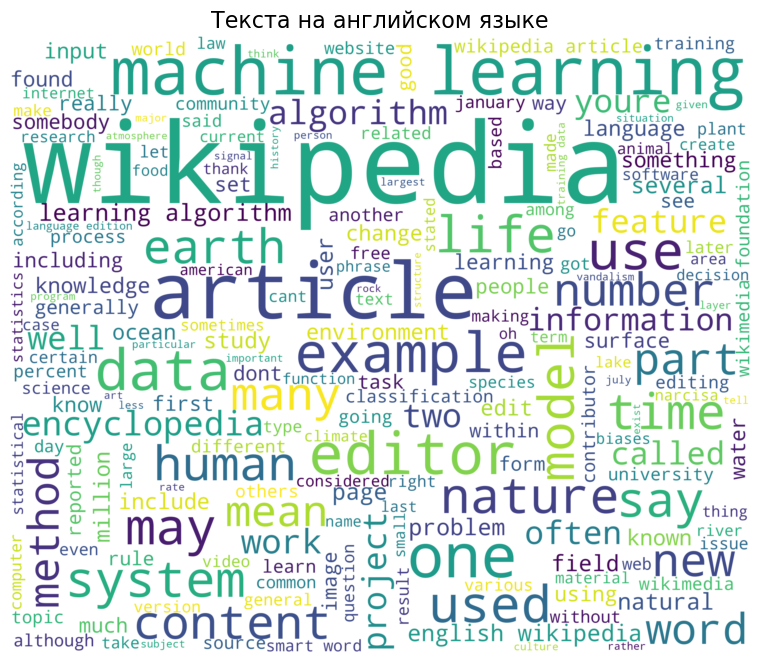

In [285]:
corpus = get_corpus(df_lang[df_lang["Language"] == "English"]['lemm_text'].values)

# Генерация облака слов
procWordCloud = get_wordCloud(corpus)

# Визуализация
fig = plt.figure(figsize=(20, 8))
plt.imshow(procWordCloud, interpolation='bilinear')
plt.axis('off')
plt.title('Текста на английском языке', fontsize=16)
plt.show()

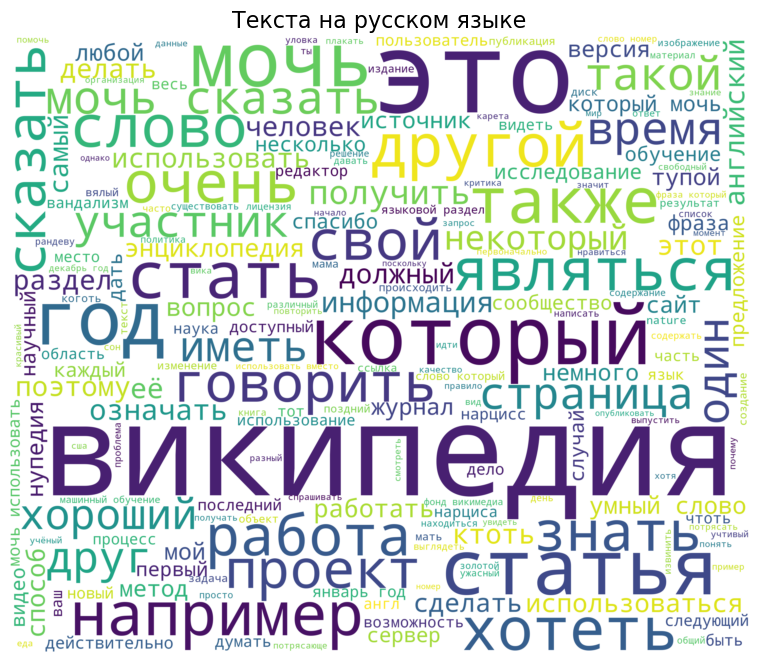

In [287]:
corpus = get_corpus(df_lang[df_lang["Language"] == "Russian"]['lemm_text'].values)

# Генерация облака слов
procWordCloud = get_wordCloud(corpus)

# Визуализация
fig = plt.figure(figsize=(20, 8))
plt.imshow(procWordCloud, interpolation='bilinear')
plt.axis('off')
plt.title('Текста на русском языке', fontsize=16)
plt.show()

### Облака слов для каждого языка

#### Подключение шрифтов для корректной обработки слов

In [291]:
import os

# Конфигурация
FONT_DIR = "noto_fonts"
os.makedirs(FONT_DIR, exist_ok=True)

# Пути к локальным файлам шрифтов
FONT_PATHS = {
    "Malayalam": os.path.join(FONT_DIR, "NotoSansMalayalam-Regular.ttf"),
    "Arabic": os.path.join(FONT_DIR, "NotoSansArabic-Regular.ttf"),
    "Hindi": os.path.join(FONT_DIR, "NotoSansDevanagari-Regular.ttf"),
    "Tamil": os.path.join(FONT_DIR, "NotoSansTamil-Regular.ttf"),
    "Greek": os.path.join(FONT_DIR, "NotoSansGreek-Regular.ttf"),
    "Kannada": os.path.join(FONT_DIR, "NotoSansKannada-Regular.ttf"),
    "Russian": os.path.join(FONT_DIR, "NotoSans-Regular.ttf"),
    "Turkish": os.path.join(FONT_DIR, "NotoSans-Regular.ttf")
}

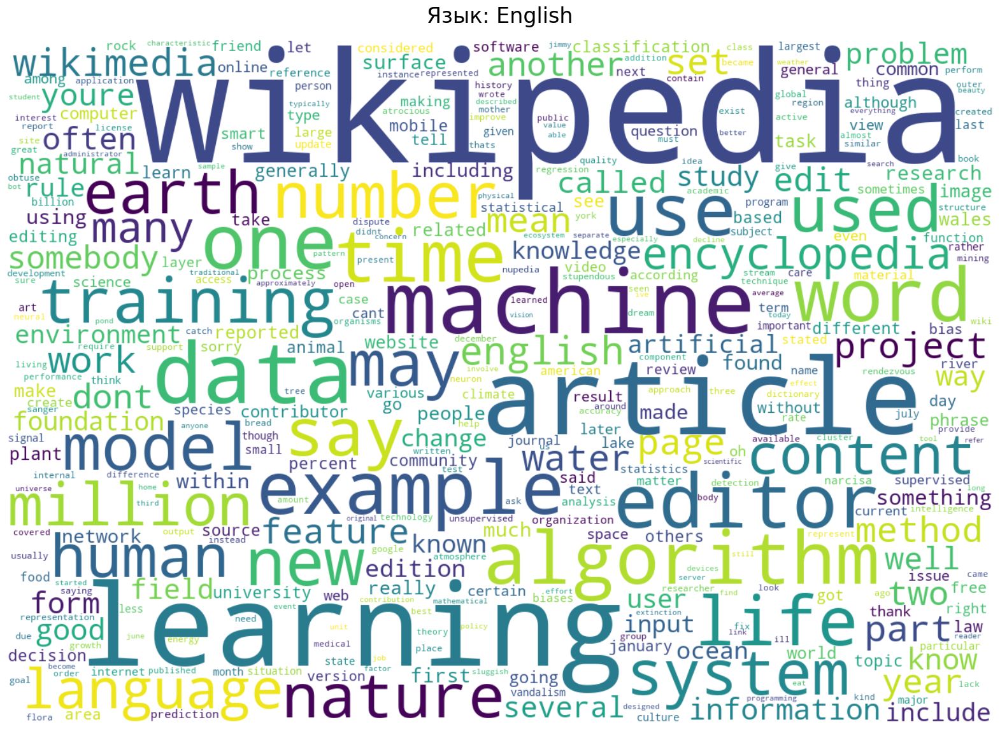

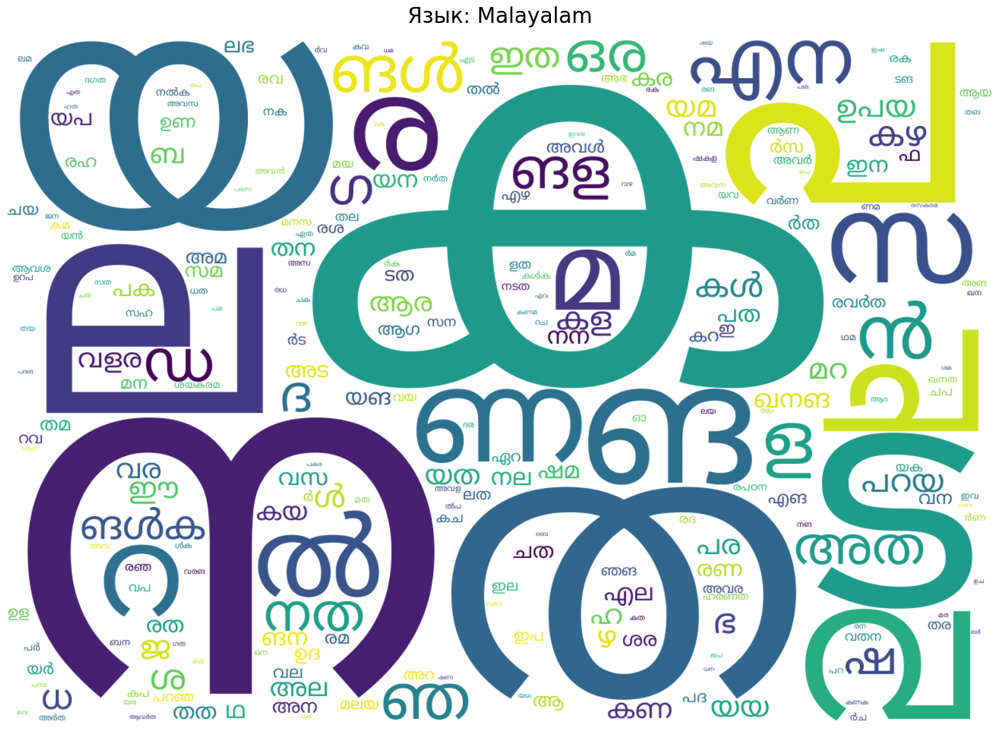

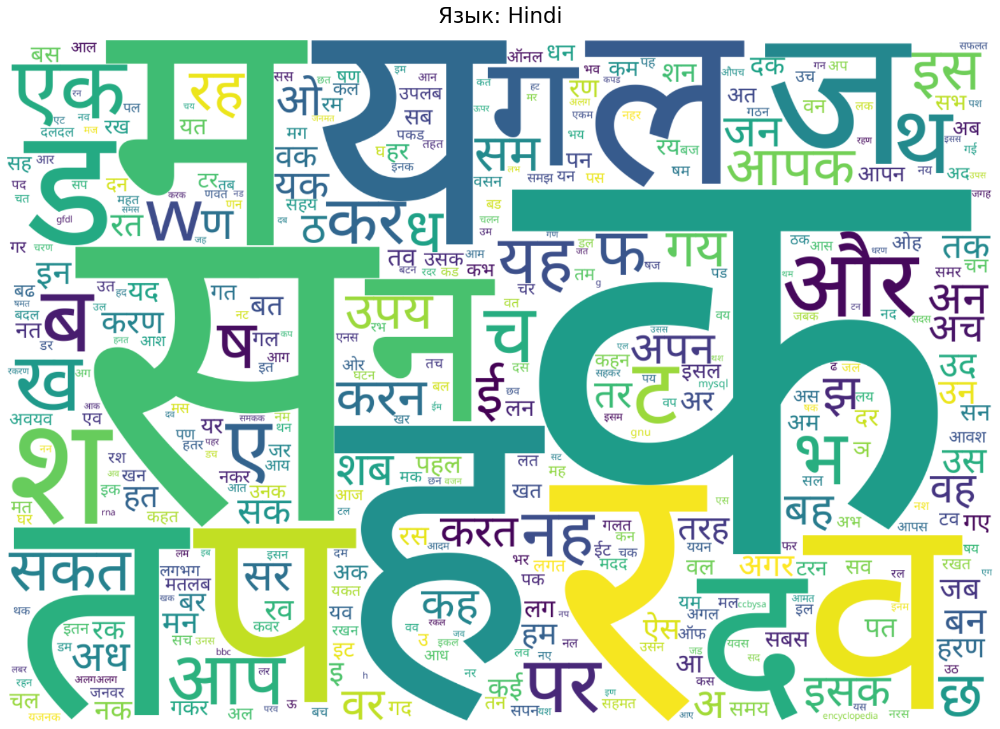

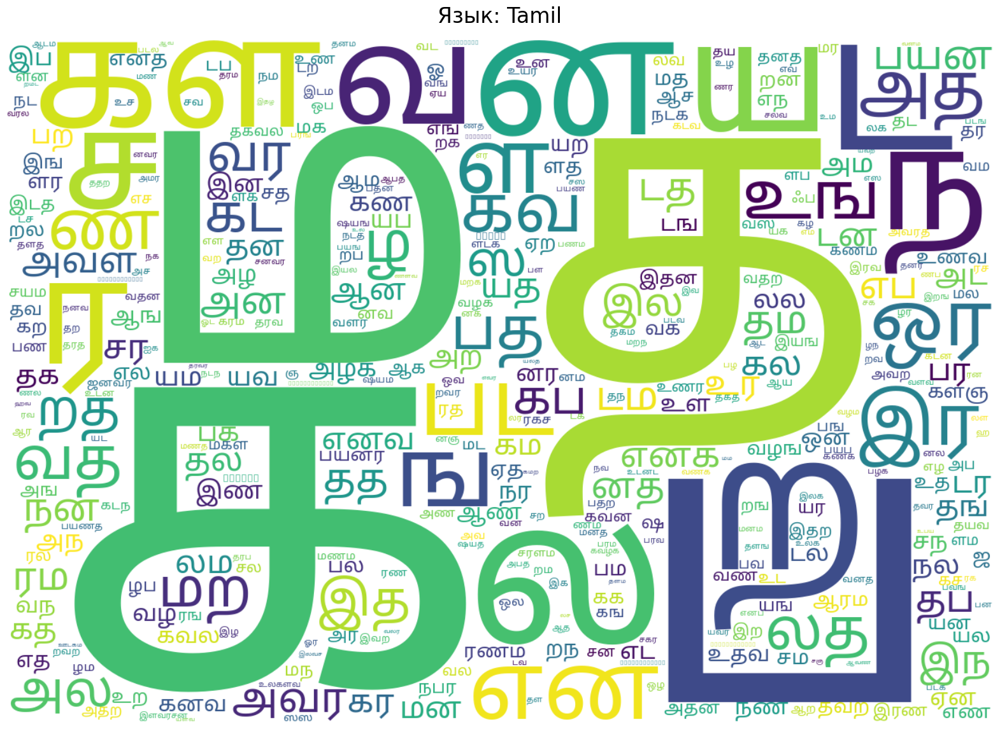

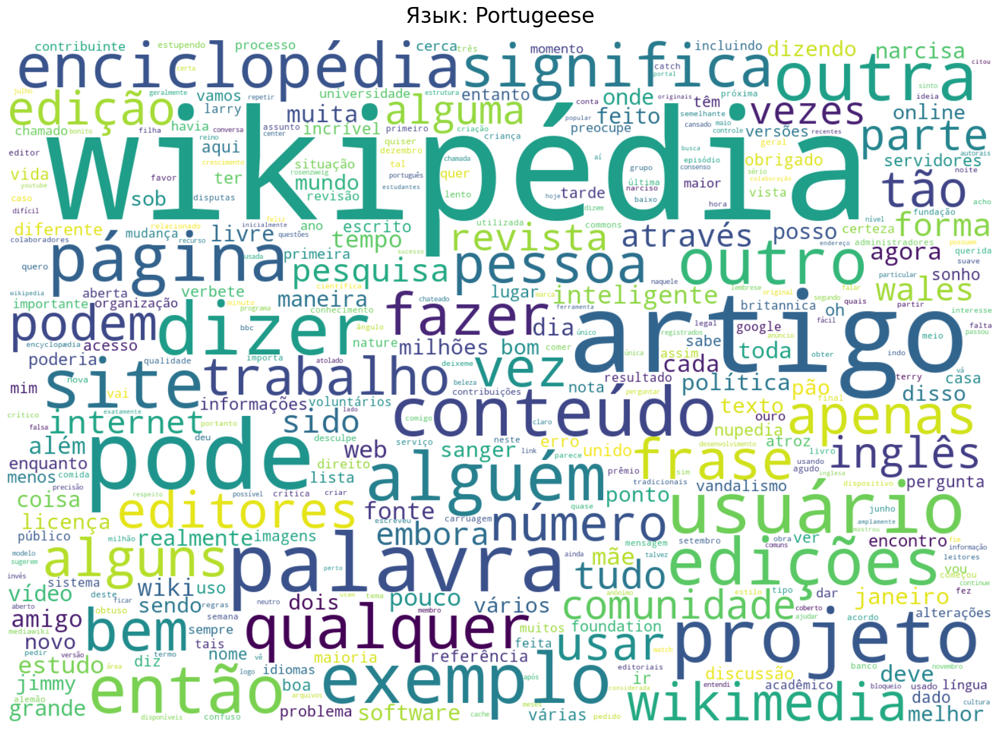

...

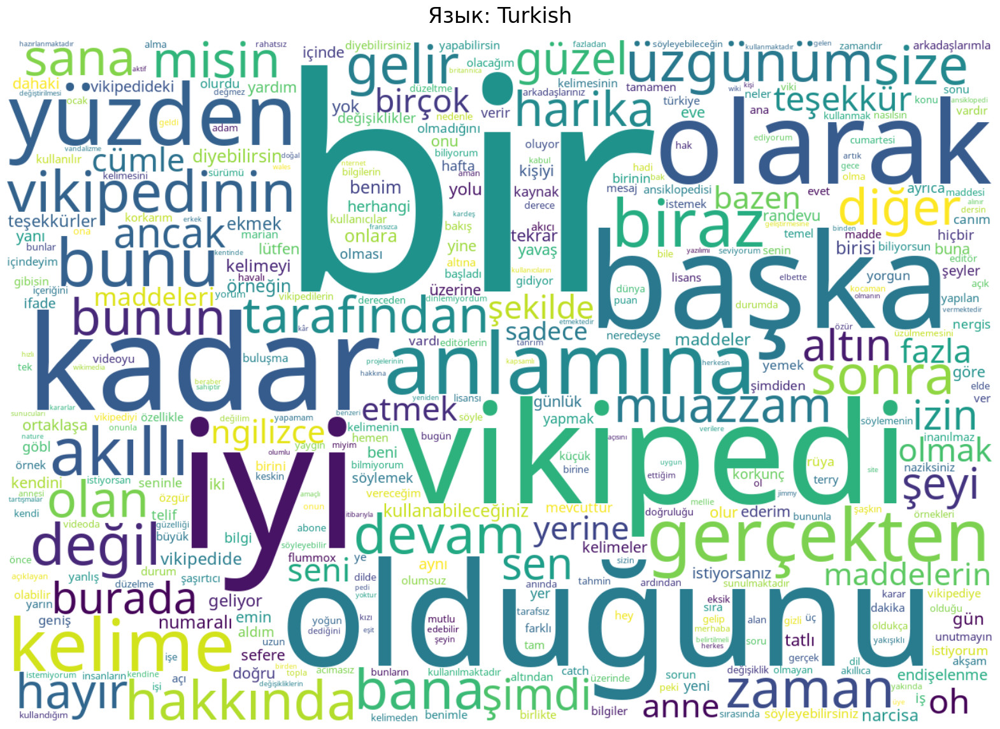

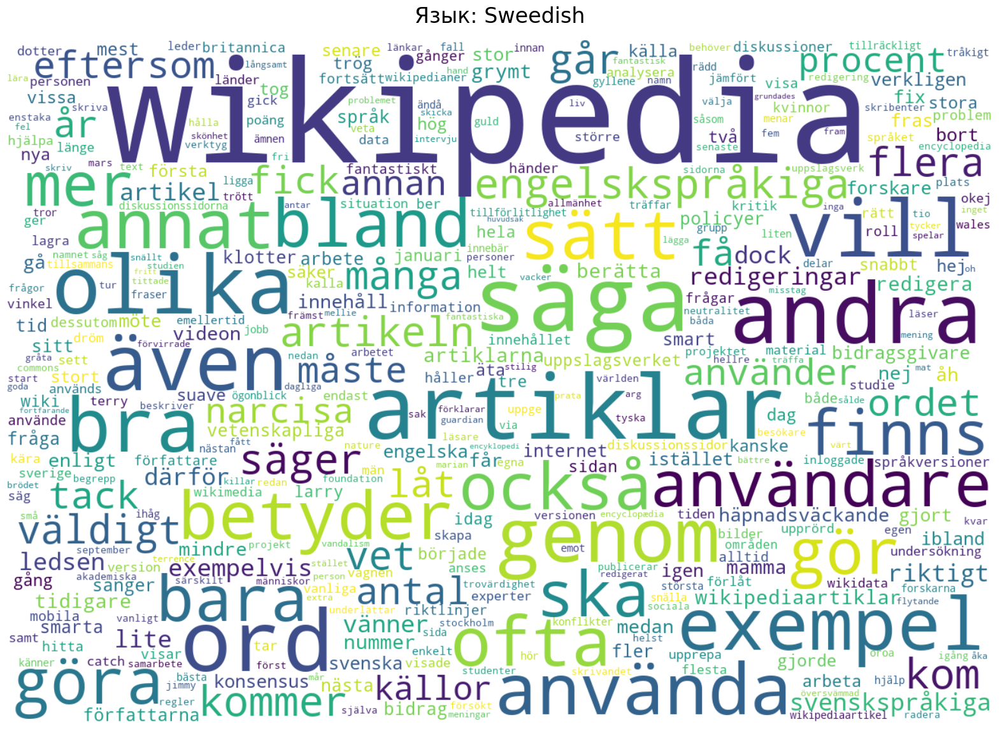

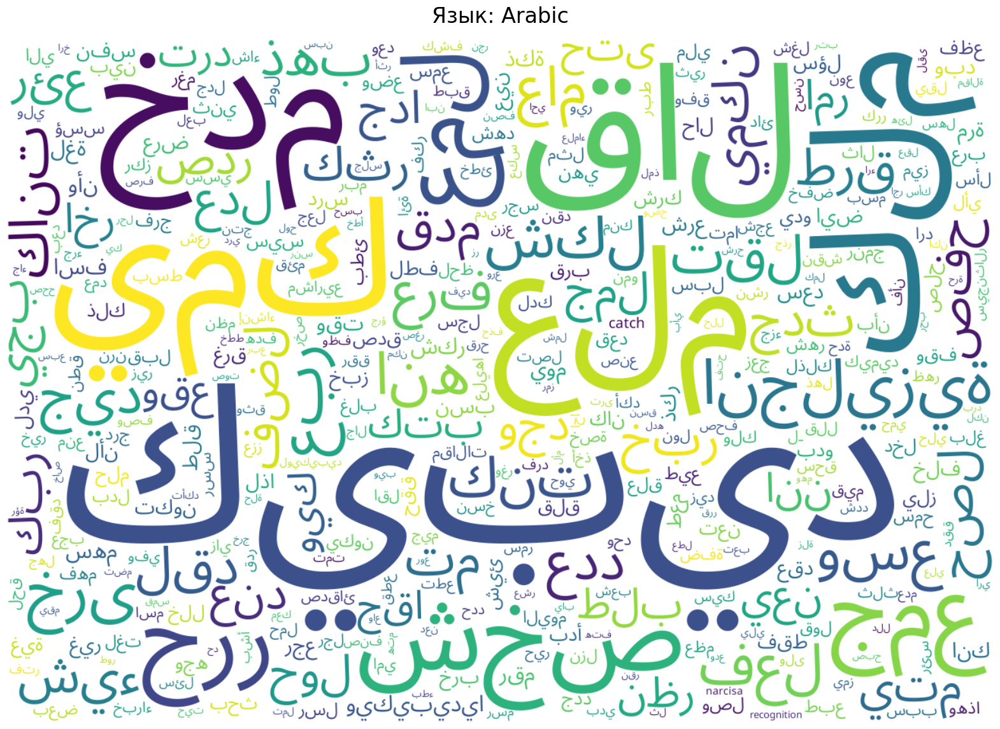

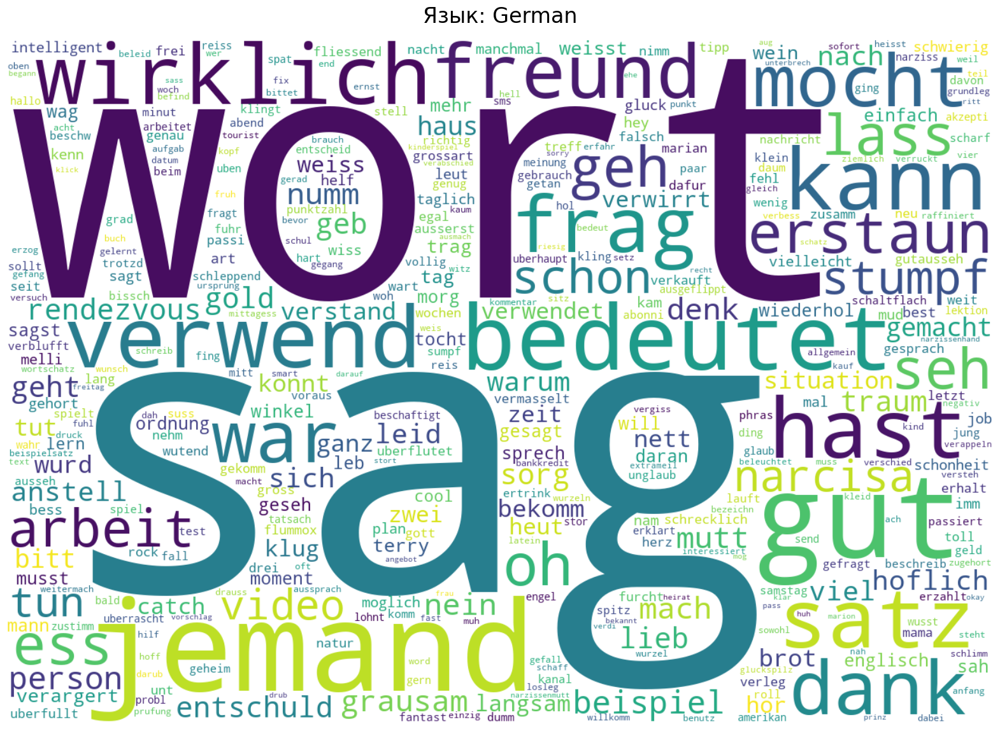

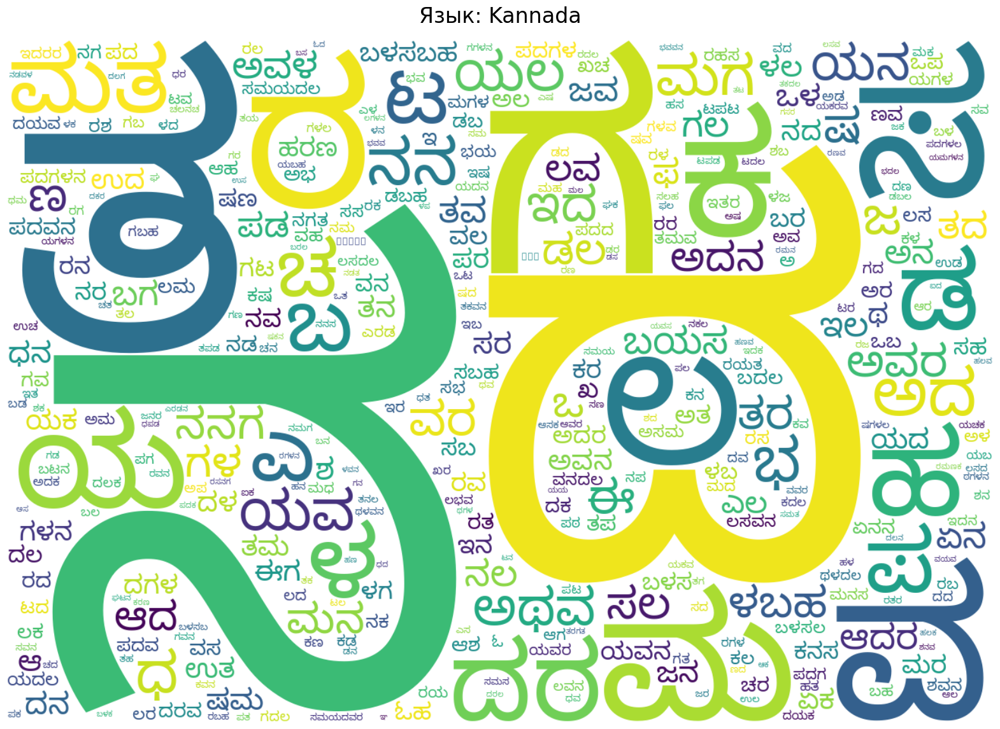

In [293]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
import os

for lang in df_lang['Language'].unique():
    texts = df_lang[df_lang['Language'] == lang]['lemm_text'].tolist()
    if not texts:
        continue
    
    font_path = None
    if lang in FONT_PATHS:
        font_path = FONT_PATHS[lang]
        if not os.path.exists(font_path):
            print(f"Шрифт для {lang} не найден, используется системный")
            font_path = None

    try:
        wc = WordCloud(
            font_path=font_path,
            width=1300,
            height=900,
            background_color='white',
            collocations=False,
            max_words=400,
            min_font_size=8,
            prefer_horizontal=0.9 if lang in ["Arabic", "Hebrew"] else 1.0
        ).generate(' '.join(texts))
        
        plt.figure(figsize=(20, 15))
        plt.imshow(wc, interpolation='bilinear')
        plt.axis('off')
        plt.title(f'Язык: {lang}', fontsize=24, pad=20)
        plt.show()
        
    except Exception as e:
        print(f"Ошибка для {lang}: {str(e)}")

#### Для каждого языка было полученно коректное облако слов

## Векторизация текстовых данных

In [302]:
from sklearn.feature_extraction.text import CountVectorizer

In [304]:
vectorizer = CountVectorizer()
vectorizer.fit(df_lang['lemm_text'])

CountVectorizer()

In [306]:
print(vectorizer.vocabulary_)

{'nature': 13689, 'broadest': 2708, 'sense': 18095, 'natural': 13684, 'physical': 15335, 'material': 12805, 'world': 22350, 'universe': 20916, 'refer': 16845, 'phenomena': 15303, 'life': 12077, 'general': 8558, 'study': 19211, 'large': 11718, 'part': 14959, 'science': 17915, 'although': 704, 'humans': 9713, 'human': 9705, 'activity': 221, 'often': 14298, 'understood': 20852, 'separate': 18118, 'category': 3092, 'word': 22340, 'borrowed': 2604, 'old': 14343, 'french': 8106, 'derived': 5054, 'latin': 11756, 'natura': 13683, 'essential': 6987, 'qualities': 16452, 'innate': 10369, 'disposition': 5599, 'ancient': 860, 'times': 20205, 'literally': 12214, 'meant': 12863, 'birth': 2479, 'philosophy': 15312, 'mostly': 13364, 'used': 21065, 'translation': 20434, 'greek': 8983, 'physis': 15344, 'φύσις': 24659, 'originally': 14650, 'related': 16964, 'intrinsic': 10629, 'characteristics': 3246, 'plants': 15449, 'animals': 925, 'features': 7565, 'develop': 5221, 'accord': 131, 'concept': 3821, 'whol

In [314]:
vectorizer = CountVectorizer(analyzer='word', stop_words=list(all_stopwords), ngram_range=(1, 3), min_df=2)
count_matrix = vectorizer.fit_transform(df_lang['lemm_text'])

C:\Users\rakhm\anaconda3\Lib\site-packages\sklearn\feature_extraction\text.py:408: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['δι', 'آمين', 'أب', 'أخ', 'أفعل', 'أفعله', 'ؤلاء', 'إل', 'إم', 'ات', 'اتان', 'ارتد', 'ان', 'انفك', 'برح', 'تان', 'تبد', 'تحو', 'تعل', 'حد', 'حم', 'حي', 'خب', 'ذار', 'سيما', 'صه', 'ظل', 'ظن', 'عد', 'قط', 'مر', 'مكان', 'مكانكن', 'نب', 'هات', 'هب', 'واها', 'وراء', 'ἀλλ'] not in stop_words.
  warnings.warn(


In [318]:
count_matrix.shape

(10337, 22222)

In [328]:
vectorizer.get_feature_names_out()[16000:16500]

array(['старый', 'статистика', 'статистический', 'статус', 'стать',
       'стать википедия', 'стать изображение', 'статья',
       'статья википедия', 'статья год', 'статья должный', 'статья её',
       'статья который', 'стоимость', 'стоить', 'стол', 'сторона',
       'страна', 'страница', 'страница википедия', 'страница обсуждение',
       'студент', 'суббота', 'суд', 'существительное', 'существовать',
       'счастливый', 'считать', 'считаться', 'сша', 'съесть', 'сэнгер',
       'сэнгера', 'также', 'также несколько', 'таковой', 'твой', 'текст',
       'телефон', 'тема', 'теория', 'термин', 'терренс', 'терри', 'тесно',
       'тест', 'технологический', 'технологический институт',
       'технология', 'товарный', 'товарный знак', 'толк', 'тон', 'тонуть',
       'топология', 'торговый', 'торговый марка', 'точка', 'точка зрение',
       'точность', 'традиционный', 'требовать', 'третий', 'тупой',
       'тупой слово', 'уверенный', 'увидеть', 'угол', 'угол это',
       'удаление', 'удали

In [330]:
print(count_matrix)

  (0, 8064)	1
  (0, 1577)	1
  (0, 10904)	1
  (0, 8056)	1
  (0, 9132)	1
  (0, 7435)	1
  (0, 13560)	1
  (0, 12485)	1
  (1, 8064)	1
  (1, 9132)	1
  (1, 13560)	1
  (1, 10170)	1
  (1, 9106)	1
  (1, 6939)	1
  (1, 4979)	1
  (1, 8066)	1
  (2, 8064)	1
  (2, 11578)	1
  (2, 6648)	1
  (2, 8878)	1
  (2, 10779)	1
  (2, 11581)	1
  (3, 8064)	1
  (3, 8056)	1
  (3, 9106)	1
  :	:
  (10334, 20137)	1
  (10334, 20743)	1
  (10334, 20582)	1
  (10334, 20510)	1
  (10334, 20539)	1
  (10335, 4091)	1
  (10335, 20119)	1
  (10335, 20485)	1
  (10335, 20065)	1
  (10335, 20406)	1
  (10336, 20146)	1
  (10336, 20715)	1
  (10336, 20488)	1
  (10336, 20238)	1
  (10336, 20077)	1
  (10336, 20205)	1
  (10336, 20057)	1
  (10336, 20274)	1
  (10336, 20159)	1
  (10336, 20626)	1
  (10336, 20164)	1
  (10336, 20107)	1
  (10336, 20108)	1
  (10336, 20700)	1
  (10336, 20701)	1


## TF-IDF

In [333]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [357]:
tfidf_vectorizer = TfidfVectorizer(analyzer='char',     
                                   ngram_range=(2, 5),  
                                   max_features=20000,  
                                   lowercase=True)

In [359]:
%%time
tfidf_matrix = tfidf_vectorizer.fit_transform(df_lang['lemm_text'])

CPU times: total: 2.61 s
Wall time: 2.65 s


In [360]:
tfidf_matrix.shape

(10337, 20000)

In [369]:
tfidf_vectorizer.get_feature_names_out()[:50]

array([' a', ' aa', ' ab', ' ac', ' aca', ' acad', ' acc', ' acce',
       ' acco', ' accu', ' ace', ' act', ' acti', ' actu', ' ad', ' ada',
       ' add', ' ade', ' adm', ' admi', ' af', ' aff', ' afi', ' ag',
       ' ago', ' agr', ' ai', ' ak', ' al', ' alc', ' alcu', ' ale',
       ' alg', ' algo', ' algu', ' all', ' alle', ' allo', ' alm', ' alo',
       ' alor', ' alt', ' alte', ' altr', ' am', ' ama', ' ame', ' amer',
       ' ami', ' amig'], dtype=object)

In [371]:
print(tfidf_matrix)

  (0, 7081)	0.07754437801857082
  (0, 8693)	0.0816994010930033
  (0, 12344)	0.08198502106725825
  (0, 1368)	0.0844972345246727
  (0, 12777)	0.09872713203395878
  (0, 1485)	0.10016102509505903
  (0, 10438)	0.08840480852302735
  (0, 5349)	0.09622393507449595
  (0, 11776)	0.09193799819354777
  (0, 3434)	0.09344099546005029
  (0, 7996)	0.09344099546005029
  (0, 793)	0.09165515140387535
  (0, 6417)	0.08212995909867433
  (0, 10192)	0.09784406457910913
  (0, 12395)	0.08818242020368498
  (0, 12082)	0.09110542005086313
  (0, 3472)	0.09222644627226276
  (0, 864)	0.06925686679735706
  (0, 5179)	0.1035374826336387
  (0, 5511)	0.10291755282198584
  (0, 12084)	0.08060983525527138
  (0, 3473)	0.0770222378154211
  (0, 8415)	0.13554080369884755
  (0, 5396)	0.0982789073772734
  (0, 12596)	0.061261022472443874
  :	:
  (10336, 18322)	0.08332071155516545
  (10336, 18602)	0.07885953379443007
  (10336, 18234)	0.08443176548639991
  (10336, 18767)	0.07731641854807364
  (10336, 18698)	0.08228232908975974
  (103

## Классификация

#### Используемые модели

* ##### RandomForestClassifier
* ##### LogisticRegression
* ##### KNN
* ##### SGDClassifier

In [376]:
X_text = tfidf_vectorizer.fit_transform(df_lang['lemm_text'])

In [378]:
from sklearn.model_selection import train_test_split
y = df_lang['Language']
X_train, X_test, y_train, y_test = train_test_split(X_text, y, test_size=0.3, random_state=19)

## RandomForestClassifier

In [384]:
from sklearn.ensemble import RandomForestClassifier
randomfc = RandomForestClassifier(n_estimators=100)
randomfc.fit(X_train, y_train)

RandomForestClassifier()

In [386]:
y_pred = randomfc.predict(X_test)

In [388]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

      Arabic       0.88      1.00      0.94       162
      Danish       0.84      0.76      0.80       135
       Dutch       0.91      0.76      0.83       155
     English       0.90      0.96      0.93       418
      French       0.92      0.94      0.93       330
      German       0.88      0.90      0.89       146
       Greek       1.00      1.00      1.00       106
       Hindi       1.00      1.00      1.00        16
     Italian       0.91      0.77      0.83       211
     Kannada       1.00      0.98      0.99       125
   Malayalam       1.00      0.99      1.00       198
  Portugeese       0.93      0.92      0.92       214
     Russian       1.00      1.00      1.00       200
     Spanish       0.80      0.84      0.82       229
    Sweedish       0.86      0.91      0.89       199
       Tamil       1.00      0.99      1.00       127
     Turkish       1.00      0.92      0.96       131

    accuracy              

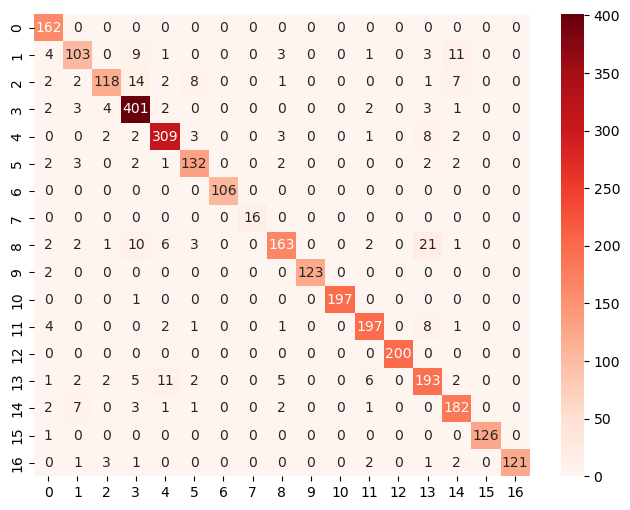

In [390]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import numpy as np

conf_matrix = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Reds')
plt.show()

## LogisticRegression

In [393]:
from sklearn.linear_model import LogisticRegression
lr = LogisticRegression(random_state = 42)
lr.fit(X_train, y_train)

LogisticRegression(random_state=42)

In [395]:
y_pred = lr.predict(X_test)
print(classification_report(y_test, y_pred, zero_division=1))

              precision    recall  f1-score   support

      Arabic       1.00      0.98      0.99       162
      Danish       0.91      0.86      0.89       135
       Dutch       0.92      0.86      0.89       155
     English       0.94      0.98      0.96       418
      French       0.96      0.98      0.97       330
      German       0.94      0.94      0.94       146
       Greek       1.00      1.00      1.00       106
       Hindi       1.00      1.00      1.00        16
     Italian       0.93      0.89      0.91       211
     Kannada       1.00      0.99      1.00       125
   Malayalam       1.00      0.99      1.00       198
  Portugeese       0.98      0.92      0.94       214
     Russian       1.00      0.99      1.00       200
     Spanish       0.83      0.93      0.88       229
    Sweedish       0.94      0.94      0.94       199
       Tamil       1.00      0.99      1.00       127
     Turkish       1.00      0.93      0.96       131

    accuracy              

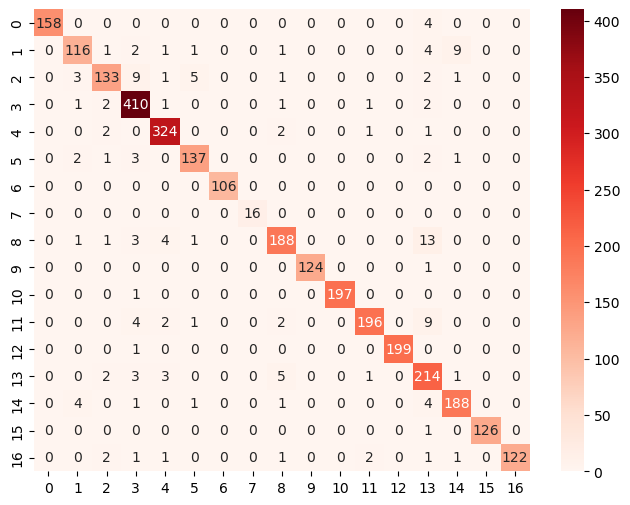

In [397]:
conf_matrix = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Reds')
plt.show()

## KNN

In [400]:
from sklearn.neighbors import KNeighborsClassifier
knn = KNeighborsClassifier(n_neighbors=5)
knn.fit(X_train, y_train)

KNeighborsClassifier()

In [402]:
y_pred = knn.predict(X_test)
print(classification_report(y_test, y_pred, zero_division=1))

              precision    recall  f1-score   support

      Arabic       0.10      0.77      0.17       162
      Danish       0.12      0.30      0.17       135
       Dutch       0.42      0.10      0.17       155
     English       0.27      0.16      0.20       418
      French       0.65      0.07      0.13       330
      German       0.33      0.13      0.19       146
       Greek       1.00      0.38      0.55       106
       Hindi       1.00      0.81      0.90        16
     Italian       0.41      0.08      0.13       211
     Kannada       1.00      0.63      0.77       125
   Malayalam       1.00      0.50      0.67       198
  Portugeese       0.21      0.09      0.13       214
     Russian       0.22      0.59      0.32       200
     Spanish       0.32      0.07      0.11       229
    Sweedish       0.28      0.11      0.15       199
       Tamil       1.00      0.69      0.81       127
     Turkish       1.00      0.10      0.18       131

    accuracy              

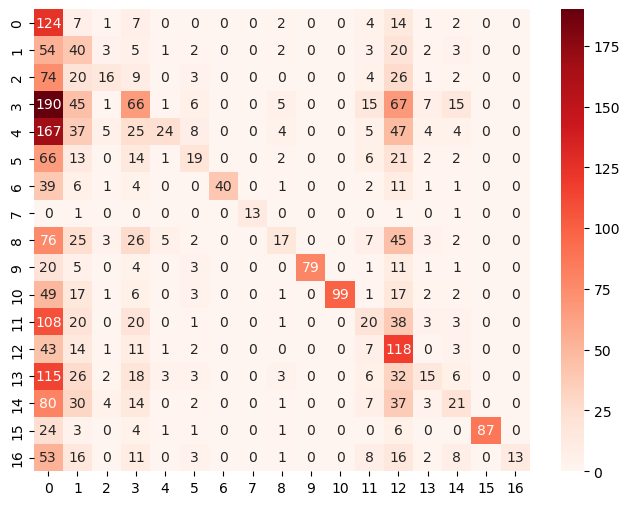

In [404]:
conf_matrix = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Reds')
plt.show()

## Анализ полученных результатов

#### При визуальом анализе определена следующая информация

* #### Лучшая модель LogisticRegression

* #### Средняя модель RandomForestClassifier

* #### Худшая модель KNN

## Сохранение полученных результатов

In [427]:
import pickle

In [429]:
# сохранение модели
with open('lr_model_lang.pkl', 'wb') as file:
    pickle.dump(lr, file)

In [431]:
#сохранение векторизации
with open('tfidf_vectorizer_lang.pkl', 'wb') as file:
    pickle.dump(tfidf_vectorizer, file)

In [433]:
# сохранение обработанного датасета
df_lang.to_csv("df_prep_lang.csv")

## Парсинг данных

In [451]:
import requests
from bs4 import BeautifulSoup
import time
import string

In [453]:
# языки для парсинга
language_codes = {
    'English': 'en',
    'Malayalam': 'ml',
    'Hindi': 'hi',
    'Tamil': 'ta',
    'Portugeese': 'pt',
    'French': 'fr',
    'Dutch': 'nl',
    'Spanish': 'es',
    'Greek': 'el',
    'Russian': 'ru',
    'Danish': 'da',
    'Italian': 'it',
    'Turkish': 'tr',
    'Swedish': 'sv',
    'Arabic': 'ar',
    'German': 'de',
    'Kannada': 'kn'
}

In [455]:
# темы для парсинга текста
topics = [
    'Sun', 'Earth', 'Mathematics', 'Computer', 'Physics',
    'Internet', 'Music', 'Football', 'Python_(programming_language)',
    'Artificial_intelligence', 'History', 'Chemistry', 'Biology',
    'Technology', 'Art', 'Literature', 'Geography', 'Medicine',
    'Psychology', 'Economics', 'Space', 'Climate', 'Energy',
    'Language', 'Education', 'Transportation', 'Agriculture',
    'Quantum_mechanics', 'Neuroscience', 'Renewable_energy', 
    'Nanotechnology', 'Genetic_engineering', 'Himalayas',
    'Amazon_River', 'Great_Barrier_Reef', 'Sahara', 'Mount_Everest',
    'World_War_II', 'Industrial_Revolution', 'French_Revolution',
    'Cold_War', 'Ancient_Egypt', 'Shakespeare', 'Mona_Lisa',
    'Bollywood', 'Olympic_Games', 'Jazz', 'Albert_Einstein',
    'Marie_Curie', 'Leonardo_da_Vinci', 'Nelson_Mandela',
    'Mahatma_Gandhi', 'DNA', 'Vaccine', 'Photosynthesis',
    'Evolution', 'CRISPR', 'Globalization', 'Democracy',
    'Human_rights', 'Climate_change', 'Artificial_neural_network',
    'Coffee', 'Chocolate', 'Internet_of_things', 'Smartphone',
    'Electric_car', 'Kerala', 'Karnataka', 'Taj_Mahal',
    'Byzantine_Empire'
]

In [459]:
# Функция парсинга (без дублирования)
def get_wikipedia_content(lang_code, topic, max_sections=3):
    url = f"https://{lang_code}.wikipedia.org/wiki/{topic}"
    try:
        response = requests.get(url, headers={'User-Agent': 'Mozilla/5.0'})
        if response.status_code != 200:
            return None
            
        soup = BeautifulSoup(response.text, 'html.parser')
        content = []
        
        # Основной текст статьи
        paragraphs = soup.find_all('p')
        content.append(' '.join([p.get_text() for p in paragraphs if p.get_text().strip()]))
        
        # Парсим первые N разделов
        sections = soup.select('h2 ~ div.mw-parser-output > p')[:max_sections]
        for section in sections:
            content.append(section.get_text(separator=' ', strip=True))
            
        return ' '.join(content)[:5000]  # Ограничим длину текста
    
    except Exception as e:
        print(f"Ошибка {url}: {e}")
        return None

In [465]:
%%time

data = []
min_text_length = 150

for topic in topics:
    for lang, code in language_codes.items():
        text = get_wikipedia_content(code, topic)
        
        if text and len(text) > min_text_length:
            processed = clean_text(text)
            if len(processed) > min_text_length//2:
                data.append({
                    'Language': lang,
                    'Text': text,
                    'prep_text': processed
                })
        
        # Для связанных страниц
        related_topics = ['History_of_' + topic, topic + '_science']
        for rel_topic in related_topics:
            rel_text = get_wikipedia_content(code, rel_topic)
            if rel_text:
                processed = clean_text(rel_text)
                data.append({
                    'Language': lang,
                    'Text': rel_text,
                    'prep_text': processed
                })
        
        time.sleep(1.5)

df_pars = pd.DataFrame(data)
df_pars = df_pars.drop_duplicates(subset=['prep_text'])
df_pars = df_pars[df_pars['prep_text'].str.len() > min_text_length//2].reset_index(drop=True)

final_df_pars = df_pars[['Language', 'Text', 'prep_text']]

print(f"Общее количество полученных текстов: {len(final_df_pars)}")
print("Распределение по языкам:")
print(final_df_pars['Language'].value_counts())

final_df_pars.head(5)

Общее количество полученных текстов: 585
Распределение по языкам:
Language
English       104
Malayalam      72
Arabic         62
German         47
French         40
Dutch          38
Danish         34
Spanish        33
Swedish        31
Russian        28
Turkish        28
Portugeese     27
Italian        22
Hindi          10
Greek           9
Name: count, dtype: int64
CPU times: total: 2min 5s
Wall time: 1h 1min 3s


,Language,Text,prep_text
0,English,The Sun is the star at the centre of the Solar...,the sun is the star at the centre of the solar...
1,Malayalam,ഭൂമി ഉൾപ്പെടുന്ന ഗ്രഹതാരസഞ്ചയമായ സൗരയൂഥത്തിന്റ...,ഭൂമി ഉൾപ്പെടുന്ന ഗ്രഹതാരസഞ്ചയമായ സൗരയൂഥത്തിന്റ...
2,Hindi,सूर्य अथवा सूरज (प्रतीक: ) सौरमंडल के केन्द्र ...,सूर्य अथवा सूरज प्रतीक सौरमंडल के केन्द्र में ...
3,French,Sur les autres projets Wikimedia : Cette page ...,sur les autres projets wikimedia cette page d’...
4,Dutch,Sun (Engels voor zon) kan verwijzen naar:\n SU...,sun engels voor zon kan verwijzen naar sun kan...


### Сохранение спрашненных данных в файл

In [468]:
final_df_pars.to_csv("df_pars_wiki.csv")

In [478]:
final_df_pars = final_df_pars.groupby('Language').first().reset_index()
final_df_pars.head(17)

,Language,Text,prep_text
0,Arabic,الشمس (رمزها: ☉) هي النجم المركزي للمجموعة الش...,الشمس رمزها ☉ هي النجم المركزي للمجموعة الشمسي...
1,Danish,Sun Microsystems er en forkortelse for Stanfor...,sun microsystems er en forkortelse for stanfor...
2,Dutch,Sun (Engels voor zon) kan verwijzen naar:\n SU...,sun engels voor zon kan verwijzen naar sun kan...
3,English,The Sun is the star at the centre of the Solar...,the sun is the star at the centre of the solar...
4,French,Sur les autres projets Wikimedia : Cette page ...,sur les autres projets wikimedia cette page d’...
5,German,Sun steht für:\n Heutige Organisationen und Ma...,sun steht für heutige organisationen und marke...
6,Greek,Το Διαδίκτυο (αγγλικά: Internet‎‎) είναι ένα π...,το διαδίκτυο αγγλικά internet‎‎ είναι ένα παγκ...
7,Hindi,सूर्य अथवा सूरज (प्रतीक: ) सौरमंडल के केन्द्र ...,सूर्य अथवा सूरज प्रतीक सौरमंडल के केन्द्र में ...
8,Italian,Un computer (pronuncia italiana: /komˈpjuter/[...,un computer pronuncia italiana komˈpjuter in i...
9,Malayalam,ഭൂമി ഉൾപ്പെടുന്ന ഗ്രഹതാരസഞ്ചയമായ സൗരയൂഥത്തിന്റ...,ഭൂമി ഉൾപ്പെടുന്ന ഗ്രഹതാരസഞ്ചയമായ സൗരയൂഥത്തിന്റ...


### Загрузка датасета со спаршенным текстом

In [573]:
df_pars_new = pd.read_csv("df_pars_wiki.csv")

In [575]:
df_pars_new.drop('Unnamed: 0', axis=1, inplace=True)

## Токенизация отпаршенного текста

In [578]:
df_pars_new['tokenize_text'] = [tokenize(text) for text in df_pars_new['prep_text']]

In [579]:
df_pars_new

,Language,Text,prep_text,tokenize_text
0,English,The Sun is the star at the centre of the Solar...,the sun is the star at the centre of the solar...,sun star centre solar system massive nearly pe...
1,Malayalam,ഭൂമി ഉൾപ്പെടുന്ന ഗ്രഹതാരസഞ്ചയമായ സൗരയൂഥത്തിന്റ...,ഭൂമി ഉൾപ്പെടുന്ന ഗ്രഹതാരസഞ്ചയമായ സൗരയൂഥത്തിന്റ...,ഭൂമി ഉൾപ്പെടുന്ന ഗ്രഹതാരസഞ്ചയമായ സൗരയൂഥത്തിന്റ...
2,Hindi,सूर्य अथवा सूरज (प्रतीक: ) सौरमंडल के केन्द्र ...,सूर्य अथवा सूरज प्रतीक सौरमंडल के केन्द्र में ...,सूर्य अथवा सूरज प्रतीक सौरमंडल के केन्द्र में ...
3,French,Sur les autres projets Wikimedia : Cette page ...,sur les autres projets wikimedia cette page d’...,autres projets wikimedia cette page ’ homonymi...
4,Dutch,Sun (Engels voor zon) kan verwijzen naar:\n SU...,sun engels voor zon kan verwijzen naar sun kan...,sun engels zon verwijzen sun verwijzen pagina ...
...,...,...,...,...
580,German,"Der Taj Mahal, auch Tadsch Mahal (persisch: ت...",der taj mahal auch tadsch mahal persisch تاج م...,taj mahal tadsch mahal persisch تاج محل dmg tā...
581,English,"The Byzantine Empire, also known as the Easter...",the byzantine empire also known as the eastern...,byzantine empire known eastern roman empire co...
582,English,The Byzantine Empire's history is generally pe...,the byzantine empires history is generally per...,byzantine empires history generally periodised...
583,Malayalam,കോൺസ്റ്റാന്റിനോപ്പിൾ തലസ്ഥാനമായി മദ്ധ്യകാലഘട്ട...,കോൺസ്റ്റാന്റിനോപ്പിൾ തലസ്ഥാനമായി മദ്ധ്യകാലഘട്ട...,കോൺസ്റ്റാന്റിനോപ്പിൾ തലസ്ഥാനമായി മദ്ധ്യകാലഘട്ട...


## Лемматизация отпаршенного текста

In [583]:
df_pars_new = add_lemmatization(df_pars_new)

In [585]:
df_pars_new

,Language,Text,prep_text,tokenize_text,lemm_text
0,English,The Sun is the star at the centre of the Solar...,the sun is the star at the centre of the solar...,sun star centre solar system massive nearly pe...,sun star centre solar system massive nearly pe...
1,Malayalam,ഭൂമി ഉൾപ്പെടുന്ന ഗ്രഹതാരസഞ്ചയമായ സൗരയൂഥത്തിന്റ...,ഭൂമി ഉൾപ്പെടുന്ന ഗ്രഹതാരസഞ്ചയമായ സൗരയൂഥത്തിന്റ...,ഭൂമി ഉൾപ്പെടുന്ന ഗ്രഹതാരസഞ്ചയമായ സൗരയൂഥത്തിന്റ...,ഭൂമി ഉൾപ്പെടുന്ന ഗ്രഹതാരസഞ്ചയമായ സൗരയൂഥത്തിന്റ...
2,Hindi,सूर्य अथवा सूरज (प्रतीक: ) सौरमंडल के केन्द्र ...,सूर्य अथवा सूरज प्रतीक सौरमंडल के केन्द्र में ...,सूर्य अथवा सूरज प्रतीक सौरमंडल के केन्द्र में ...,सूर्य अथवा सूरज प्रतीक सौरमंडल के केन्द्र में ...
3,French,Sur les autres projets Wikimedia : Cette page ...,sur les autres projets wikimedia cette page d’...,autres projets wikimedia cette page ’ homonymi...,autr projet wikimedi cet pag ’ homonym réperto...
4,Dutch,Sun (Engels voor zon) kan verwijzen naar:\n SU...,sun engels voor zon kan verwijzen naar sun kan...,sun engels zon verwijzen sun verwijzen pagina ...,sun engel zon verwijz sun verwijz pagina stat ...
...,...,...,...,...,...
580,German,"Der Taj Mahal, auch Tadsch Mahal (persisch: ت...",der taj mahal auch tadsch mahal persisch تاج م...,taj mahal tadsch mahal persisch تاج محل dmg tā...,taj mahal tadsch mahal persisch تاج محل dmg tā...
581,English,"The Byzantine Empire, also known as the Easter...",the byzantine empire also known as the eastern...,byzantine empire known eastern roman empire co...,byzantine empire known eastern roman empire co...
582,English,The Byzantine Empire's history is generally pe...,the byzantine empires history is generally per...,byzantine empires history generally periodised...,byzantine empires history generally periodised...
583,Malayalam,കോൺസ്റ്റാന്റിനോപ്പിൾ തലസ്ഥാനമായി മദ്ധ്യകാലഘട്ട...,കോൺസ്റ്റാന്റിനോപ്പിൾ തലസ്ഥാനമായി മദ്ധ്യകാലഘട്ട...,കോൺസ്റ്റാന്റിനോപ്പിൾ തലസ്ഥാനമായി മദ്ധ്യകാലഘട്ട...,കോൺസ്റ്റാന്റിനോപ്പിൾ തലസ്ഥാനമായി മദ്ധ്യകാലഘട്ട...


In [587]:
df_pars_new.to_csv("df_pars_wiki_prep.csv")

In [589]:
with open('tfidf_vectorizer_lang.pkl', 'rb') as file:
    tfidf_vectorizer = pickle.load(file)

X_parsed = tfidf_vectorizer.transform(df_pars_new['lemm_text'])

In [590]:
with open('lr_model_lang.pkl', 'rb') as file:
    lr = pickle.load(file)

# Предсказание и вероятности
y_parsed_pred = lr.predict(X_parsed)
y_parsed_proba = lr.predict_proba(X_parsed)

In [591]:
print(classification_report(df_pars_new['Language'], y_parsed_pred, zero_division=1))

              precision    recall  f1-score   support

      Arabic       1.00      1.00      1.00        62
      Danish       1.00      0.94      0.97        34
       Dutch       1.00      0.97      0.99        38
     English       0.95      1.00      0.98       104
      French       1.00      1.00      1.00        40
      German       1.00      0.98      0.99        47
       Greek       1.00      1.00      1.00         9
       Hindi       1.00      1.00      1.00        10
     Italian       1.00      1.00      1.00        22
   Malayalam       1.00      1.00      1.00        72
  Portugeese       1.00      1.00      1.00        27
     Russian       1.00      0.96      0.98        28
     Spanish       1.00      1.00      1.00        33
     Swedish       1.00      0.00      0.00        31
    Sweedish       0.00      1.00      0.00         0
     Turkish       1.00      1.00      1.00        28

    accuracy                           0.94       585
   macro avg       0.93   

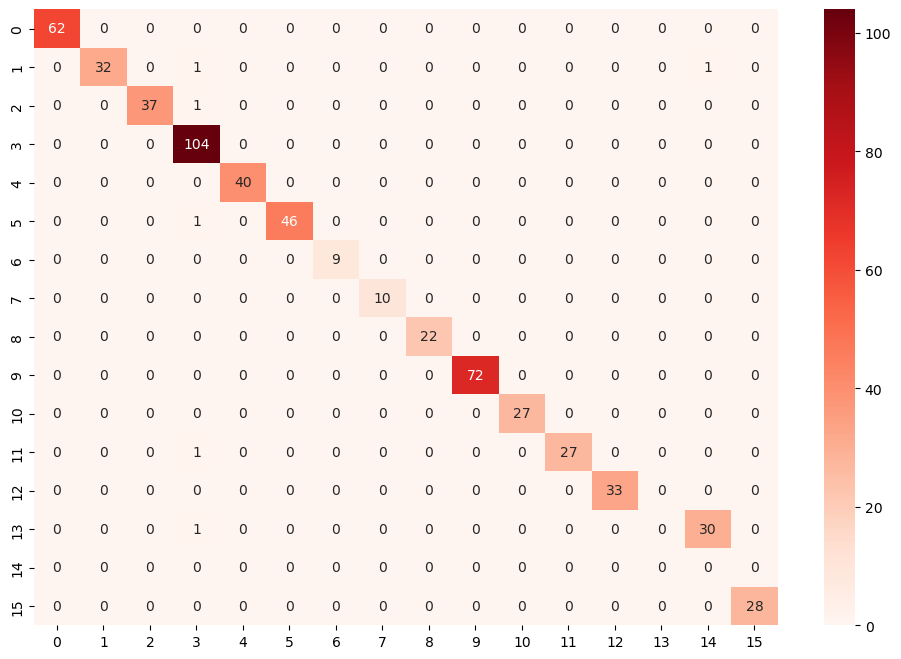

In [592]:
plt.figure(figsize=(12, 8))
sns.heatmap(confusion_matrix(df_pars_new['Language'], y_parsed_pred), annot=True, fmt='d', cmap='Reds')
plt.show()

In [597]:
np.random.seed(42)
sample_indices = np.random.choice(df_pars_new.index, size=5, replace=False)

print("Примеры предсказаний:\n")
for idx in sample_indices:
    proba = np.max(y_parsed_proba[idx]) * 100
    pred_lang = y_parsed_pred[idx]
    true_lang = df_pars_new.loc[idx, 'Language'] if 'Language' in df_pars_new.columns else 'N/A'
    
    text_preview = ' '.join(df_pars_new.loc[idx, 'lemm_text'].split()[:8])
    print(f"Текст [{idx}]: {text_preview}...")
    print(f"Предсказание: {pred_lang} ({proba:.1f}%)")
    if 'Language' in df_pars.columns:
        print(f"Истинный язык: {true_lang}\n")

Примеры предсказаний:

Текст [383]: mari skłodowskacuri født polsk maria salomea skłodowska novemb...
Предсказание: Danish (86.6%)
Истинный язык: Danish

Текст [422]: махатм моханда́с карамча́нд га́нди гуджа મોહનદાસ કરમચંદ મહાત્મા...
Предсказание: Russian (100.0%)
Истинный язык: Russian

Текст [90]: python highlevel generalpurpose programming language design philosophy emphasizes...
Предсказание: English (99.8%)
Истинный язык: English

Текст [472]: crispr англclustered regularly interspaced short palindromic repeats короткий...
Предсказание: Russian (100.0%)
Истинный язык: Russian

Текст [523]: sak internet engelskan internet thing iot samlingsnamn teknik...
Предсказание: Sweedish (95.4%)
Истинный язык: Swedish



## Итеративное дообучение модели

In [637]:
import numpy as np
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import pickle

# Загрузка данных
df_lang = pd.read_csv("df_prep_lang.csv") 
df_pars = pd.read_csv("df_pars_wiki_prep.csv")

# Функция предобработки
def preprocess_data(df):
    df = df.dropna(subset=['Text', 'lemm_text']).copy()
    df = df[df['lemm_text'].str.strip().astype(bool)]
    return df.reset_index(drop=True)

# Инициализация
current_train_df = preprocess_data(df_lang)
remaining_data = preprocess_data(df_pars)
iterations = 3

for i in range(1, iterations+1):
    print(f"Итерация {i}/{iterations}")
    
    # 1. Предобработка
    remaining_data = remaining_data.reset_index(drop=True)
    remaining_data['prep_text'] = remaining_data['Text'].apply(clean_text)
    remaining_data['tokenize_text'] = remaining_data['prep_text'].apply(tokenize)
    remaining_data = add_lemmatization(remaining_data)
    
    # 2. Векторизация
    tfidf = TfidfVectorizer(analyzer='char', ngram_range=(2,5), max_features=20000)
    X_train = tfidf.fit_transform(current_train_df['lemm_text'])
    y_train = current_train_df['Language']
    
    # 3. Обучение модели
    lr = LogisticRegression(max_iter=1000)
    lr.fit(X_train, y_train)
    
    # 4. Предсказания
    X_remaining = tfidf.transform(remaining_data['lemm_text'])
    probas = lr.predict_proba(X_remaining)
    max_probas = np.max(probas, axis=1)
    
    # 5. Отбор данных
    mask = (max_probas > 0.8) | (max_probas < 0.2)
    selected_data = remaining_data.loc[mask].copy().reset_index(drop=True)
    selected_data['Language'] = lr.predict(X_remaining[mask])
    
    # 6. Визуальная проверка
    if not selected_data.empty:
        print("\nПримеры добавляемых текстов:")
        sample_size = min(2, len(selected_data))
        sample_indices = np.random.choice(
            len(selected_data), 
            size=sample_size, 
            replace=(len(selected_data) < 2)
        )
        
        for idx in sample_indices:
            row = selected_data.iloc[idx]
            text_preview = ' '.join(row['lemm_text'].split()[:10])
            confidence = max_probas[mask][idx] * 100
            
            print(f"\nТекст [{idx}]: {text_preview}...")
            print(f"Предсказанный язык: {row['Language']}")
            print(f"Уверенность: {confidence:.1f}%")
    
    # 7. Обновление данных
    current_train_df = pd.concat([current_train_df, selected_data], ignore_index=True)
    remaining_data = remaining_data[~mask].reset_index(drop=True)
    
    # 8. Сохранение состояния
    current_train_df.to_csv(f"current_train_iteration_{i}.csv", index=False)
    remaining_data.to_csv(f"remaining_data_iteration_{i}.csv", index=False)
    
    # 9. Оценка модели
    X, y = tfidf.transform(current_train_df['lemm_text']), current_train_df['Language']
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)
    lr = LogisticRegression(max_iter=1000).fit(X_train, y_train)
    print("\nТекущая точность модели:")
    print(classification_report(y_test, lr.predict(X_test)))
    
    print(f"\nДобавлено текстов: {len(selected_data)}")
    print(f"Осталось текстов: {len(remaining_data)}")

# Сохранение
print("\nПроцесс завершен! Итоговые файлы:")
print(f"- Тренировочные данные: current_train_iteration_{iterations}.csv")
print(f"- Оставшиеся данные: remaining_data_iteration_{iterations}.csv")

# Сохранение в файлы векторизацию и модель
with open('final_tfidf_vectorizer.pkl', 'wb') as f:
    pickle.dump(tfidf, f)

with open('final_lr_model.pkl', 'wb') as f:
    pickle.dump(lr, f)

print("\nМодель и векторизатор успешно сохранены!")

Итерация 1/3

Примеры добавляемых текстов:

Текст [271]: ثور رنس رنس révolution française فتر ؤثر ضطراب اجتماعية سيس...
Предсказанный язык: Arabic
Уверенность: 100.0%

Текст [127]: veroffentlich februar genr poprock alternativ rock posthardcor titelanzahl lang besetz...
Предсказанный язык: German
Уверенность: 93.3%

Текущая точность модели:
              precision    recall  f1-score   support

      Arabic       1.00      0.99      1.00       162
      Danish       0.94      0.93      0.94       144
       Dutch       0.95      0.87      0.91       176
     English       0.93      0.98      0.96       448
      French       0.96      0.98      0.97       304
      German       0.94      0.93      0.93       157
       Greek       1.00      1.00      1.00       116
       Hindi       1.00      1.00      1.00        25
     Italian       0.96      0.94      0.95       229
     Kannada       1.00      1.00      1.00       101
   Malayalam       1.00      0.99      1.00       186
  Portug

## Вывод

В ходе выполнения данной работы была решена задача автоматического определения языка текста на основе методов машинного обучения.  
Работа включала в себя несколько ключевых этапов: сбор и подготовку данных, их предварительную обработку, векторизацию текстовых признаков и построение классификационных моделей.

**1. Данные:**
Изначально использовался датасет `TextLanguage.csv`, содержащий тексты на различных языках. Для расширения обучающей выборки и проверки обобщающей способности модели был выполнен парсинг текстовых данных из Википедии по большому кругу тем на нескольких языках. Это позволило получить дополнительный набор текстов (`df_pars_wiki.csv`), который в дальнейшем использовался в процессе итеративного дообучения.

**2. Предобработка текста:**
Ключевым этапом подготовки данных стала их тщательная предобработка. Этот процесс включал:
    *   Приведение текста к нижнему регистру.
    *   Удаление знаков препинания, цифр и специальных символов.
    *   Удаление лишних пробелов.
    *   Токенизацию текста на слова.
    *   Удаление стоп-слов с использованием общих списков для поддерживаемых языков.
    *   Лемматизацию токенов с применением специфичных для каждого языка инструментов (Pymorphy3 для русского, WordNetLemmatizer для английского, ISRIStemmer для арабского, Snowball Stemmer для ряда европейских языков). Этот этап позволил привести слова к их нормальной форме, что способствует улучшению качества признакового пространства.

**3. Векторизация и моделирование:**
Для преобразования текстовых данных в числовые векторы был выбран метод TF-IDF (`TfidfVectorizer`).

Были рассмотрены и протестированы несколько моделей классификации:
    *   RandomForestClassifier
    *   LogisticRegression
    *   KNeighborsClassifier (KNN)

На основе метрик качества **наилучшие результаты показала модель LogisticRegression.** Она продемонстрировала высокую точность и хорошие показатели по всем языкам.

**4. Итеративное дообучение:**
С целью дальнейшего улучшения качества модели и использования собранных неразмеченных данных был применен итеративный подход. На каждой итерации модель, обученная на текущем наборе данных, предсказывала метки для части данных которые изначально были пропущены. Записи, в которых модель была наиболее уверена, добавлялись с псевдо-метками в обучающий набор, после чего модель и векторизатор переобучались. Этот процесс позволил постепенно расширять обучающую выборку и адаптировать модель к новым данным.

**5. Результаты и сохранение данных:**
По завершении всех этапов были сохранены:
    *   Финальная обученная модель Logistic Regression (`final_lr_model.pkl`).
    *   Соответствующий ей TF-IDF векторизатор (`final_tfidf_vectorizer.pkl`).
    *   Обработанные датасеты, полученные на различных стадиях работы.

Полученная модель готова к использованию для определения языка предоставленного текста.

Таким образом, в рамках проекта была успешно разработана и оценена система для определения языка текста, а также продемонстрирован подход к ее итеративному улучшению.